In [2]:
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
from matplotlib import pyplot
import seaborn as sns

## What is the question?

In [3]:
# Can one model be used for all areas?
# Does using an inland model work on coastal areas? - separate tables of inland and coastal = in_model, co_model
# What is the difference between a decision tree (with little preprocessing) and a regular processed model?
# What are monthly trends? - Make a Time Series = df_ts

In [4]:
df = pd.read_csv("weatherAUS.csv")

In [5]:
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0.0,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0.0,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,0.0,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,1.0,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0.2,No


In [6]:
df.shape

(142193, 24)

In [7]:
df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RISK_MM          float64
RainTomorrow      object
dtype: object

## Pandas Profiling

In [8]:
profile = ProfileReport(df, title = 'AusWeather Profile Report')

In [9]:
profile

In [10]:
#Numerical columns have mostly normal distributions, except rainfall, evaporation and sunshine

In [11]:
df.select_dtypes(include=['number'])

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RISK_MM
0,13.4,22.9,0.6,NaN,NaN,44.0,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,0.0
1,7.4,25.1,0.0,NaN,NaN,44.0,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,0.0
2,12.9,25.7,0.0,NaN,NaN,46.0,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,0.0
3,9.2,28.0,0.0,NaN,NaN,24.0,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,1.0
4,17.5,32.3,1.0,NaN,NaN,41.0,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142188,3.5,21.8,0.0,NaN,NaN,31.0,15.0,13.0,59.0,27.0,1024.7,1021.2,NaN,NaN,9.4,20.9,0.0
142189,2.8,23.4,0.0,NaN,NaN,31.0,13.0,11.0,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,0.0
142190,3.6,25.3,0.0,NaN,NaN,22.0,13.0,9.0,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,0.0
142191,5.4,26.9,0.0,NaN,NaN,37.0,9.0,9.0,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,0.0


In [12]:
# Where was the max rainfall?
df[df['Rainfall'] == df['Rainfall'].max()]
# Coffs Harbour had the most rainfall

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
9236,2009-11-07,CoffsHarbour,17.4,23.1,371.0,NaN,3.5,NaN,NaN,SW,...,81.0,1026.6,1025.9,8.0,5.0,18.6,22.0,Yes,4.8,Yes


In [13]:
# More about Coffs Harbour
most_rain = df[df['Rainfall'] == df['Rainfall'].max()]

In [14]:
print(most_rain.MinTemp)
print(most_rain.MaxTemp)
print(most_rain.Humidity9am)
print(most_rain.Humidity3pm)
print(most_rain.Temp3pm)

9236    17.4
Name: MinTemp, dtype: float64
9236    23.1
Name: MaxTemp, dtype: float64
9236    93.0
Name: Humidity9am, dtype: float64
9236    81.0
Name: Humidity3pm, dtype: float64
9236    22.0
Name: Temp3pm, dtype: float64


In [15]:
day_before_most_rain = df[(df.Date == '2009-11-06') & (df.Location == 'CoffsHarbour')]

In [16]:
print(day_before_most_rain.Rainfall)
print(day_before_most_rain.MaxTemp)
print(day_before_most_rain.Humidity9am)
print(day_before_most_rain.Humidity3pm)
print(day_before_most_rain.Temp3pm)

9235    96.0
Name: Rainfall, dtype: float64
9235    21.4
Name: MaxTemp, dtype: float64
9235    94.0
Name: Humidity9am, dtype: float64
9235    88.0
Name: Humidity3pm, dtype: float64
9235    20.8
Name: Temp3pm, dtype: float64


In [17]:
# Looks like humidity dropped even during the day before the most rainfall

In [18]:
# What location had the least amount of rainfall across the whole period of the dataset?
df.groupby('Location')['Rainfall'].mean().sort_values()

Location
Woomera             0.489946
Uluru               0.707324
AliceSprings        0.869355
Nhil                0.932907
Mildura             0.945025
SalmonGums          1.032302
Cobar               1.129262
Nuriootpa           1.381375
MelbourneAirport    1.451977
Sale                1.512667
Adelaide            1.572185
Moree               1.603296
Hobart              1.604273
Bendigo             1.621452
PearceRAAF          1.634354
Ballarat            1.688830
WaggaWagga          1.706085
Canberra            1.735038
PerthAirport        1.761648
Melbourne           1.837772
Watsonia            1.847692
Perth               1.906295
Albury              1.925710
Launceston          2.012219
MountGambier        2.087359
Penrith             2.135143
Dartmoor            2.148554
Richmond            2.152581
Tuggeranong         2.159040
BadgerysCreek       2.207925
Albany              2.255073
Portland            2.531032
Walpole             2.877329
Witchcliffe         2.899658
Sydne

## Make a column for whether a location is coastal or not

In [19]:
inland = ['Albury', 'AliceSprings', 'BadgerysCreek', 'Ballarat', 'Bendigo', 'Canberra', 'Cobar', 'Katherine', 'Mildura', 'Moree', 'MountGinini', 'Nhil', 'Nuriootpa', 'PearceRAAF', 'Penrith', 'Richmond', 'SalmonGums', 'Tuggeranong', 'Uluru', 'WaggaWagga', 'Woomera']

coast = []

for i in df.Location:
    if i in inland:
        coast.append(0)
    else:
        coast.append(1)

In [20]:
df['Coastal'] = coast

In [21]:
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow,Coastal
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0.0,No,0
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0.0,No,0
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,1007.6,1008.7,NaN,2.0,21.0,23.2,No,0.0,No,0
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,1017.6,1012.8,NaN,NaN,18.1,26.5,No,1.0,No,0
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0.2,No,0


In [22]:
# Save new column to csv
# df.to_csv('weatherAUS_coast.csv', index = False)

In [23]:
df.groupby('Coastal')['Humidity3pm'].mean().sort_values()

Coastal
0    43.414112
1    57.122550
Name: Humidity3pm, dtype: float64

## Make a Time Series for EDA

In [24]:
# Convert 'Date' column to datetime, can then see monthly trends
df['Date'] = pd.to_datetime(df['Date'], format = '%Y/%m/%d')

In [25]:
df.dtypes

Date             datetime64[ns]
Location                 object
MinTemp                 float64
MaxTemp                 float64
Rainfall                float64
Evaporation             float64
Sunshine                float64
WindGustDir              object
WindGustSpeed           float64
WindDir9am               object
WindDir3pm               object
WindSpeed9am            float64
WindSpeed3pm            float64
Humidity9am             float64
Humidity3pm             float64
Pressure9am             float64
Pressure3pm             float64
Cloud9am                float64
Cloud3pm                float64
Temp9am                 float64
Temp3pm                 float64
RainToday                object
RISK_MM                 float64
RainTomorrow             object
Coastal                   int64
dtype: object

In [133]:
# Make Time Series DataFrame with Year, Month, Day columns
df_ts = df.set_index('Date')

In [134]:
df_ts['Year'] = df_ts.index.year
df_ts['Month'] = df_ts.index.month
df_ts['Day'] = df_ts.index.day

df_ts.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow,Coastal,Year,Month,Day
Date,,,,,,,,,,,,,,,,,,,,,
2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,...,NaN,16.9,21.8,No,0.0,No,0,2008,12,1
2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,...,NaN,17.2,24.3,No,0.0,No,0,2008,12,2
2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,...,2.0,21.0,23.2,No,0.0,No,0,2008,12,3
2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,...,NaN,18.1,26.5,No,1.0,No,0,2008,12,4
2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,...,8.0,17.8,29.7,No,0.2,No,0,2008,12,5


In [33]:
df_ts.columns

Index(['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RISK_MM', 'RainTomorrow', 'Coastal', 'Year',
       'Month', 'Day'],
      dtype='object')

In [29]:
df_ts['Coastal'] = coast

In [103]:
#df_ts.to_csv('weatherAUS_ts.csv', index = False)

In [30]:
df_ts.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow,Coastal,Year,Month,Day
Date,,,,,,,,,,,,,,,,,,,,,
2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,...,NaN,16.9,21.8,No,0.0,No,0,2008,12,1
2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,...,NaN,17.2,24.3,No,0.0,No,0,2008,12,2
2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,...,2.0,21.0,23.2,No,0.0,No,0,2008,12,3
2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,...,NaN,18.1,26.5,No,1.0,No,0,2008,12,4
2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,...,8.0,17.8,29.7,No,0.2,No,0,2008,12,5


# Meaningful Information

In [31]:
#Are there any outliers?
df.describe().T

# There will absolutely be outliers

,count,mean,std,min,25%,50%,75%,max
MinTemp,141556.0,12.186400,6.403283,-8.5,7.6,12.0,16.8,33.9
MaxTemp,141871.0,23.226784,7.117618,-4.8,17.9,22.6,28.2,48.1
Rainfall,140787.0,2.349974,8.465173,0.0,0.0,0.0,0.8,371.0
Evaporation,81350.0,5.469824,4.188537,0.0,2.6,4.8,7.4,145.0
Sunshine,74377.0,7.624853,3.781525,0.0,4.9,8.5,10.6,14.5
WindGustSpeed,132923.0,39.984292,13.588801,6.0,31.0,39.0,48.0,135.0
WindSpeed9am,140845.0,14.001988,8.893337,0.0,7.0,13.0,19.0,130.0
WindSpeed3pm,139563.0,18.637576,8.803345,0.0,13.0,19.0,24.0,87.0
Humidity9am,140419.0,68.843810,19.051293,0.0,57.0,70.0,83.0,100.0
Humidity3pm,138583.0,51.482606,20.797772,0.0,37.0,52.0,66.0,100.0


In [32]:
df[df['Rainfall'] < 100.0]

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow,Coastal
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0.0,No,0
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0.0,No,0
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,1007.6,1008.7,NaN,2.0,21.0,23.2,No,0.0,No,0
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,1017.6,1012.8,NaN,NaN,18.1,26.5,No,1.0,No,0
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0.2,No,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142188,2017-06-20,Uluru,3.5,21.8,0.0,NaN,NaN,E,31.0,ESE,...,1024.7,1021.2,NaN,NaN,9.4,20.9,No,0.0,No,0
142189,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,1024.6,1020.3,NaN,NaN,10.1,22.4,No,0.0,No,0
142190,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,1023.5,1019.1,NaN,NaN,10.9,24.5,No,0.0,No,0
142191,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,1021.0,1016.8,NaN,NaN,12.5,26.1,No,0.0,No,0


## Make some ts plots for features, inland vs coastal

In [113]:
df_ts.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow,Coastal
Date,,,,,,,,,,,,,,,,,,,,,
2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,...,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0.0,No,0
2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,...,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0.0,No,0
2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,...,1007.6,1008.7,NaN,2.0,21.0,23.2,No,0.0,No,0
2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,...,1017.6,1012.8,NaN,NaN,18.1,26.5,No,1.0,No,0
2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,...,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0.2,No,0


In [135]:
df_ts.drop(['Location','RISK_MM','Evaporation','Sunshine','WindGustDir', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 
       'Pressure9am',  'Cloud9am', 'Cloud3pm', 'Temp9am',
        'RainToday', 'RISK_MM'], axis = 1, inplace = True)

In [136]:
df_ts.columns

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'WindGustSpeed', 'Humidity3pm',
       'Pressure3pm', 'Temp3pm', 'RainTomorrow', 'Coastal', 'Year', 'Month',
       'Day'],
      dtype='object')

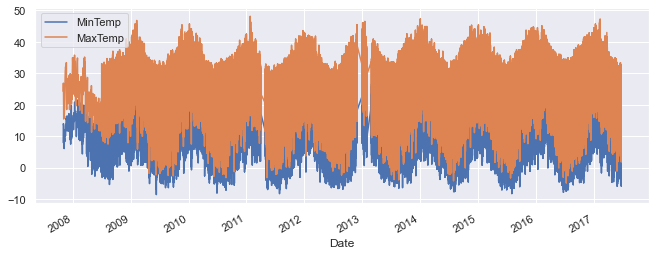

In [137]:
df_ts[['MinTemp','MaxTemp']].plot()

In [138]:
ts_inland = df_ts[df_ts['Coastal']==0]

In [139]:
ts_coastal = df_ts[df_ts['Coastal']==1]

In [61]:
sns.set(rc={'figure.figsize':(11, 4)})

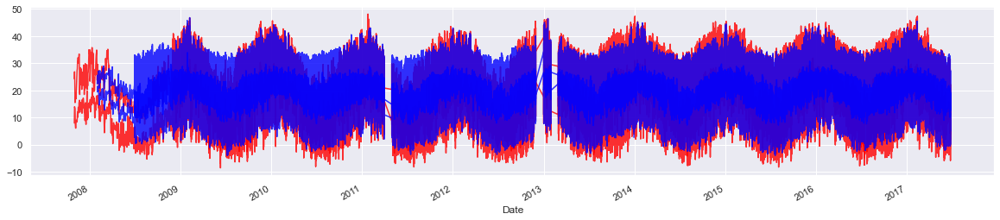

In [209]:
ts_inland['MaxTemp'].plot(figsize = (20,4), alpha = 0.8, color = 'red')
ts_inland['MinTemp'].plot(alpha = 0.8, color = 'red')
ts_coastal['MaxTemp'].plot(alpha = 0.8, color = 'blue')
ts_coastal['MinTemp'].plot(alpha = 0.8, color = 'blue')

In [141]:
ts_coastal.groupby(['Year','Month']).agg('mean')

MinTemp    MaxTemp  Rainfall  WindGustSpeed  Humidity3pm  \
Year Month                                                               
2008 2      18.503448  24.751724  8.910345            NaN    64.551724   
     3      17.364516  25.067742  2.045161            NaN    57.967742   
     4      13.906667  21.516667  4.886667            NaN    58.966667   
     5      11.400000  20.535484  0.096774            NaN    54.806452   
     6      11.910000  18.606667  4.240000            NaN    61.900000   
...               ...        ...       ...            ...          ...   
2017 2      17.565349  27.508486  3.765608      42.108538    55.425770   
     3      17.520624  26.661695  5.063043      40.773902    60.488491   
     4      13.761125  23.363625  2.369016      36.389034    57.142674   
     5      11.486548  20.594179  1.820163      34.473958    60.890000   
     6       9.656777  18.866913  3.022321      34.219472    62.354890   

            Pressure3pm    Temp3pm  Coastal        Day  
Year Month                                              
2008 2      1012.106897  23.203448      1.0  15.000000  
     3      1018.393548  24.077419      1.0  16.000000  
     4      1018.896667  20.363333      1.0  15.500000  
     5      1019.079355  19.461290      1.0  16.000000  
     6      1021.430000  17.820000      1.0  15.500000  
...                 ...        ...      ...        ...  
2017 2      1012.569522  25.788375      1.0  14.566406  
     3      1013.374711  25.177905      1.0  15.977488  
     4      1018.664175  22.012082      1.0  15.615942  
     5      1018.960276  19.326375      1.0  15.924506  
     6      1022.651969  17.747476      1.0  12.994118  

[110 rows x 9 columns]

In [147]:
coastagg = ts_coastal.groupby(['Year','Month']).agg('mean')
inlandagg = ts_inland.groupby(['Year','Month']).agg('mean')

In [145]:
ts_coastal_m = coastagg[['MaxTemp','MinTemp']]

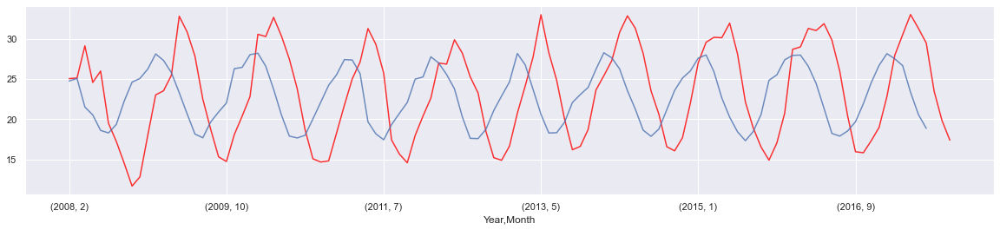

In [151]:
inlandagg['MaxTemp'].plot(figsize = (20,4), alpha = 0.8, color = 'red')
coastagg['MaxTemp'].plot(alpha = 0.8)


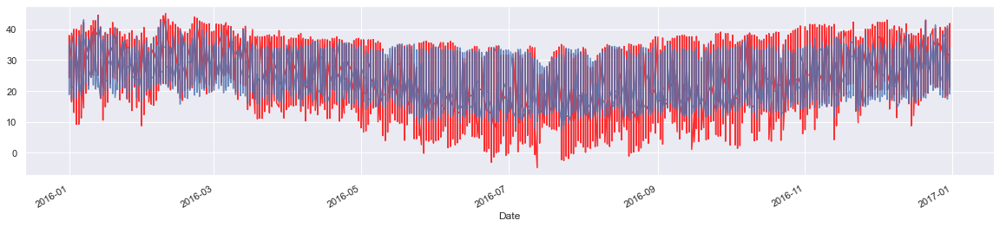

In [129]:
ts_inland.loc['2016','MaxTemp'].plot(figsize = (20,4), alpha = 0.8, color = 'red')
ts_coastal.loc['2016','MaxTemp'].plot(alpha = 0.8)

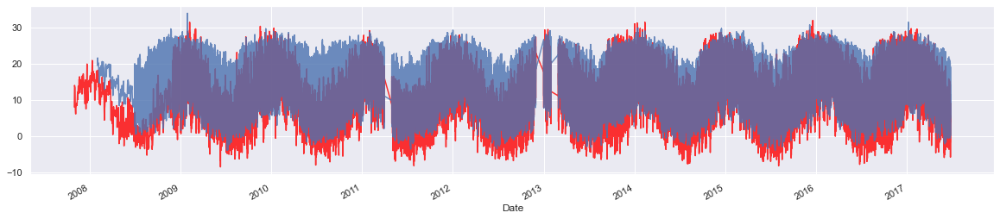

In [93]:
ts_inland['MinTemp'].plot(figsize = (20,4), alpha = 0.8, color = 'red')
ts_coastal['MinTemp'].plot(alpha = 0.8)

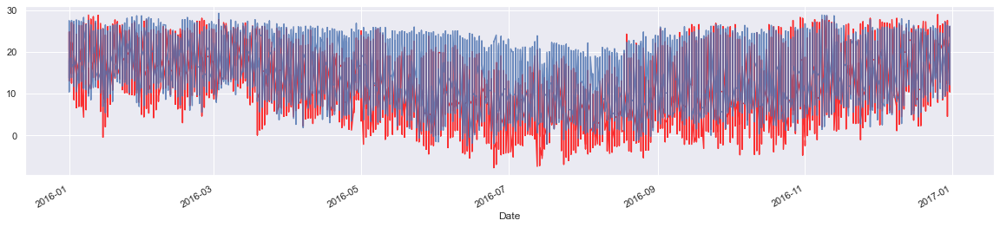

In [94]:
ts_inland.loc['2016','MinTemp'].plot(figsize = (20,4), alpha = 0.8, color = 'red')
ts_coastal.loc['2016','MinTemp'].plot(alpha = 0.8)

In [ ]:
.loc['2016','MinTemp']

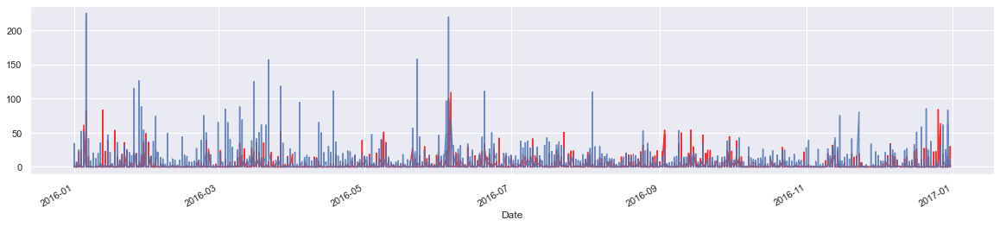

In [95]:
ts_inland.loc['2016','Rainfall'].plot(figsize = (20,4), alpha = 0.8, color = 'red')
ts_coastal.loc['2016','Rainfall'].plot(alpha = 0.8)

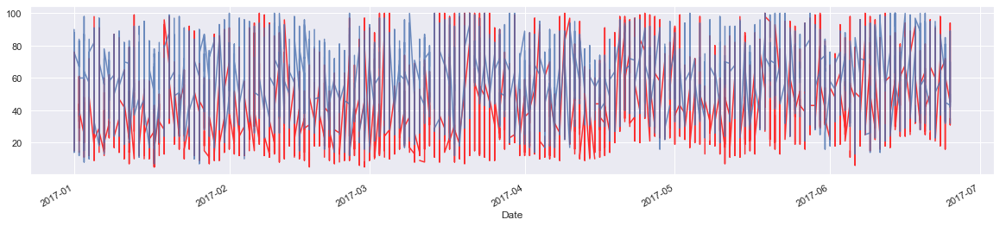

In [96]:
ts_inland.loc['2017','Humidity3pm'].plot(figsize = (20,4), alpha = 0.8, color = 'red')
ts_coastal.loc['2017','Humidity3pm'].plot(alpha = 0.8)

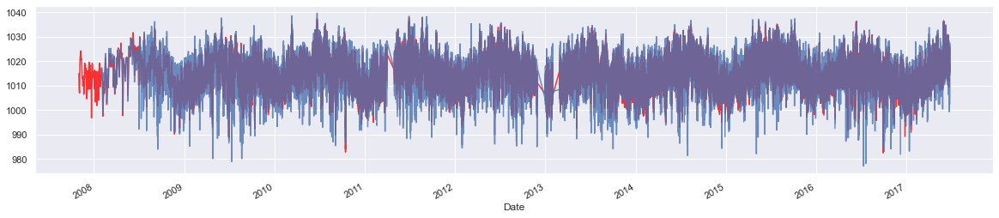

In [97]:
ts_inland['Pressure3pm'].plot(figsize = (20,4), alpha = 0.8, color = 'red')
ts_coastal['Pressure3pm'].plot(alpha = 0.8)

In [ ]:
.loc['2016','Pressure3pm']

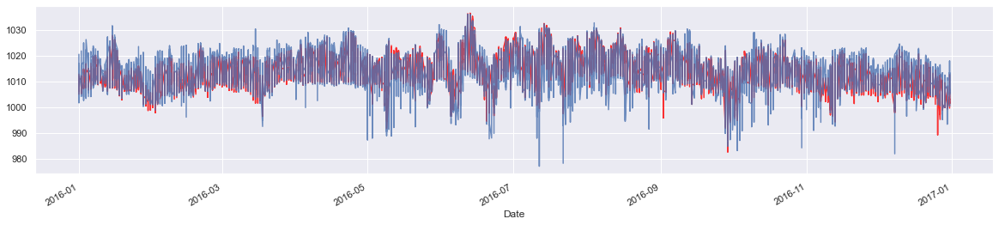

In [98]:
ts_inland.loc['2016','Pressure3pm'].plot(figsize = (20,4), alpha = 0.8, color = 'red')
ts_coastal.loc['2016','Pressure3pm'].plot(alpha = 0.8)

## Monthly points rather than daily points

In [169]:
inlandagg['AveTemp'] = inlandagg['MaxTemp'] - inlandagg['MinTemp']
coastagg['AveTemp'] = coastagg['MaxTemp'] - coastagg['MinTemp']

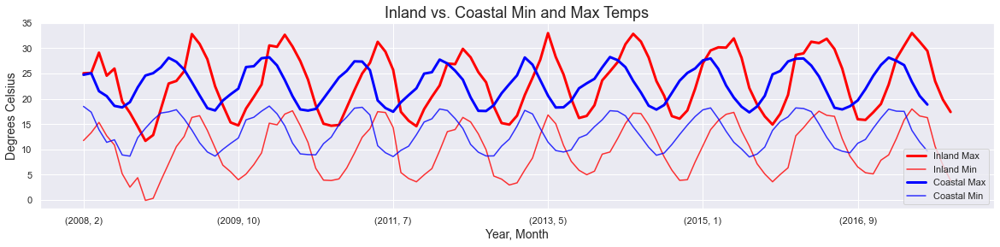

In [203]:
inlandagg['MaxTemp'].plot(figsize = (20,4), alpha = 1, color = 'red', linewidth = 3)
inlandagg['MinTemp'].plot(figsize = (20,4), alpha = 0.8, color = 'red')
coastagg['MaxTemp'].plot(alpha = 1, color = 'blue', linewidth=3)
coastagg['MinTemp'].plot(alpha = 0.8, color = 'blue')
plt.title('Inland vs. Coastal Min and Max Temps', size = 18)
plt.ylabel('Degrees Celsius', size = 14)
plt.yticks(range(0,36,5))
plt.xlabel('Year, Month', size = 14)
plt.legend(['Inland Max','Inland Min','Coastal Max','Coastal Min'])

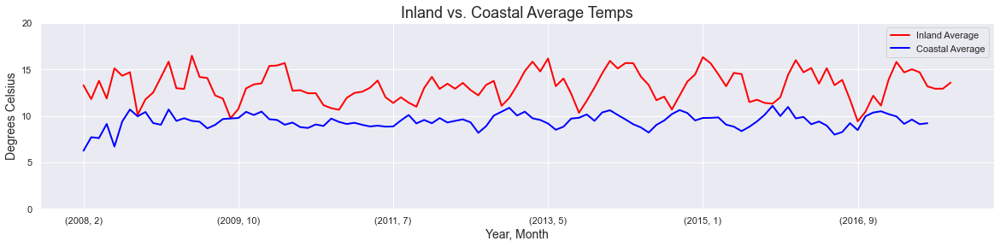

In [205]:
inlandagg['AveTemp'].plot(figsize = (20,4), alpha = 1, color = 'red', linewidth = 2)
coastagg['AveTemp'].plot(alpha = 1, color = 'blue', linewidth=2)
plt.title('Inland vs. Coastal Average Temps', size = 18)
plt.ylabel('Degrees Celsius', size = 14)
plt.xlabel('Year, Month', size = 14)
plt.yticks(range(0,21,5))
plt.legend(['Inland Average','Coastal Average'])

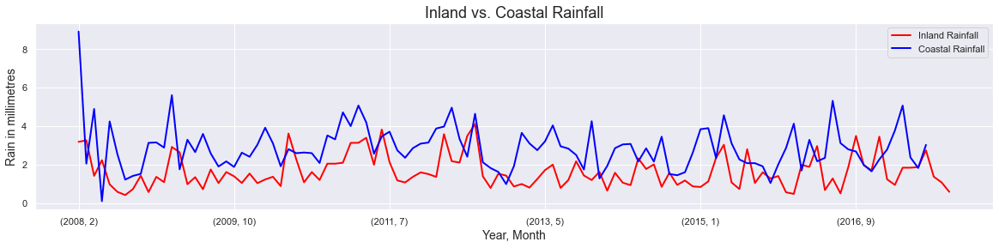

In [179]:
inlandagg['Rainfall'].plot(figsize = (20,4), alpha = 1, color = 'red', linewidth = 2)
coastagg['Rainfall'].plot(alpha = 1, color = 'blue', linewidth = 2)
plt.title('Inland vs. Coastal Rainfall', size = 18)
plt.ylabel('Rain in millimetres', size = 14)
plt.xlabel('Year, Month', size = 14)
plt.legend(['Inland Rainfall','Coastal Rainfall'])

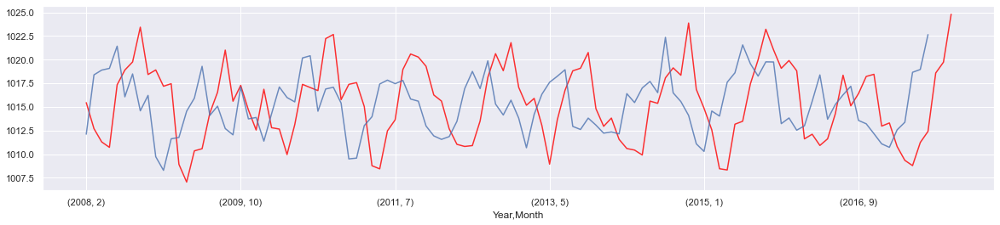

In [154]:
inlandagg['Pressure3pm'].plot(figsize = (20,4), alpha = 0.8, color = 'red')
coastagg['Pressure3pm'].plot(alpha = 0.8)

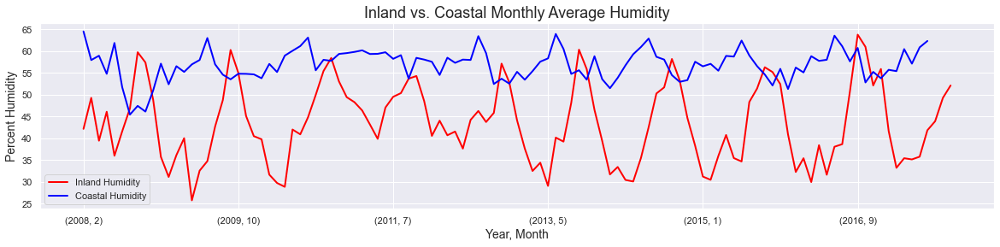

In [185]:
inlandagg['Humidity3pm'].plot(figsize = (20,4), alpha = 1, color = 'red', linewidth = 2)
coastagg['Humidity3pm'].plot(alpha = 1,  color = 'blue', linewidth = 2)
plt.title('Inland vs. Coastal Monthly Average Humidity', size = 18)
plt.ylabel('Percent Humidity', size = 14)
plt.xlabel('Year, Month', size = 14)
plt.legend(['Inland Humidity','Coastal Humidity'])